# Setup

__Import libraries used by thisnotebook.__

In [1200]:
from time import time
begin_time = time()
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

from PIL import Image
import requests
from io import BytesIO
import matplotlib.pyplot as plt


import torchvision.transforms as transforms
import torchvision.models as models

import copy
from google.colab import files



In [1201]:
!rm -rf style.png
!rm -rf content.png
uploaded = files.upload()

Saving content.png to content.png
Saving style.png to style.png


__Select computation device accordingly to what is available.__

If this machine have a gpu (cuda is available) we use it. Otherwise our fallback is the CPU.

In [1202]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


__Hyperparameters__

Hyperparameters control the number of iteration, size of image, and relative ration between losses (content, style, and denoising).

Fine tuning this parameter will affect the final result of the picture.

In [1264]:
ITERATIONS = 80 # Number of iterations
IMAGE_WIDTH = 512 # 512x512 is fine for HD images
IMAGE_HEIGHT = 512
CONTENT_WEIGHT = 1 # Weight of the content loss
STYLE_WEIGHT = 30.0 # Weight of the style loss
TOTAL_VARIATION_WEIGHT = 50.0 # Weight of the total variation loss
INPUT_IMAGE = 'content' # Can be : 'noise', 'content', 'style', or a path to a file.

Thw next parameters are the heart of the algorithm, They deeply affect the result of combining style and content, because they define what IS the style and content.

To compute style and content, we use a deep neural network called VGG. Here is how VGG looks like inside.
![VGG Layers](https://www.researchgate.net/profile/Clifford_Yang/publication/325137356/figure/fig2/AS:670371271413777@1536840374533/llustration-of-the-network-architecture-of-VGG-19-model-conv-means-convolution-FC-means.jpg)

Tu compute the style of an image, we run the image through VGG. Then, we look at what values flowed across the layers (named _conv1_1_, _conv1_2_, etc.) and keep some of them.

For the __content__, we usually keep the first layers. The last convolutional layer from the second block is always a good bet.

For the __style__, a mix of the first conv layers (they contain color and texture informations) and last layers (they contain complexe features like trees, shapes, eyes, etc...) gives the best results.

---


__The names of layers you can add the the following lists in order to define the style and content loss are:__
  * `conv_n` where `n` is the index of the convolutional layer from the input.
  * `relu_n` where `n` is the index of the rectified linear layer from the input.
  * `pool_n` where `n` is the index of the max pooling layer from the input.
  * `bn_n` zhere `n` is the index of the batch normalization layer from the input.
  
  
  For example, convolutional layers are indexed from `conv_1` to `conv_16`.

In [1265]:
content_layers = ['conv_1', 'conv_2', 'conv_4']
style_layers = ['conv_2', 'conv_3', 'conv_4', 'conv_7', 'conv_10', 'conv_8']

Names under which the images will be saved.

In [1266]:
content_image_path = "content.png"
style_image_path = "style.png"
output_image_path = "result.png"
combined_image_path = "combined.png"

# Image selection

### Images

We download pitctures from the web, but you can also give the path to an image stored on this machine.

Just drag and drop your file on the left menu under the tab "Files", and write the name of the file (including extension) in place of the url. :)

This is the list of URL we selectionned for you, because they looks nice.

In [1267]:
# Content images
san_francisco = "https://www.economist.com/sites/default/files/images/print-edition/20180602_USP001_0.jpg"
cat = "https://t1.uc.ltmcdn.com/fr/images/4/5/5/img_comment_soigner_un_chat_de_la_maladie_de_carre_9554_orig.jpg"
dog = "https://raw.githubusercontent.com/gaganbahga/cosine_art/master/test_images/test_image_2.jpg"
doge = "https://raw.githubusercontent.com/codazzo/dogr/master/public/doge.png"
  
# Style images:
tytus = "http://meetingbenches.com/wp-content/flagallery/tytus-brzozowski-polish-architect-and-watercolorist-a-fairy-tale-in-warsaw/tytus_brzozowski_13.jpg" #Warsaw by Tytus Brzozowski, http://t-b.pl
tytus_second = "http://t-b.pl/attachments/kamienice-na-pancerze-2017.jpg"
elephant = "https://images.yaoota.com/FNOKU0Srh8eNe-i-VRAfb4tm7S8=/trim/yaootaweb-production-ng/media/crawledproductimages/4d226297bb4d97b03abcb2c76073a90888068ac0.jpg"
colorswir = "https://paintings.pinotspalette.com/colorful-swirly-sky-tv.jpg?v=10026315"
scream = "https://painting-planet.com/images/1/image046.jpg"

style_file = "style.png"
content_file = "content.png"

# The function which allow us to download / open an image
def open_image(url):
  if url.startswith("http"):
    return Image.open(BytesIO(requests.get(url).content)).convert('RGB')
  else:
    return Image.open(url).convert('RGB')


This is where you select your __Content image__ and __Style Image__.

In [1268]:
content_url = content_file
style_url = style_file

### Image loading

(998, 994)
(512, 512)


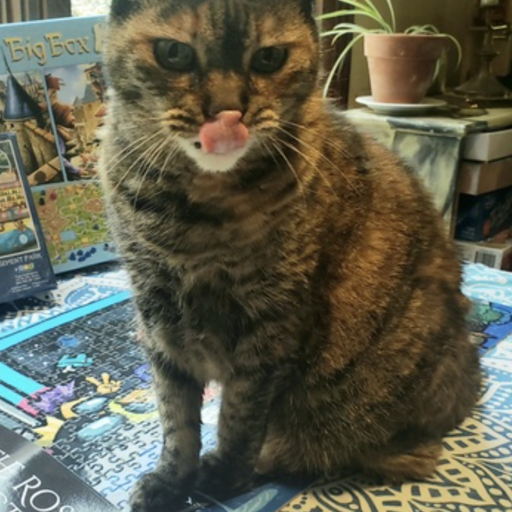

In [1269]:
#@title This is the _content_ image
content_image = open_image(content_url)
original_image_size = content_image.size
print(original_image_size)
content_image.save(content_image_path)
content_image = content_image.resize((IMAGE_WIDTH, IMAGE_HEIGHT), resample=Image.BICUBIC)
print(content_image.size)
content_image

(994, 990)
(512, 512)


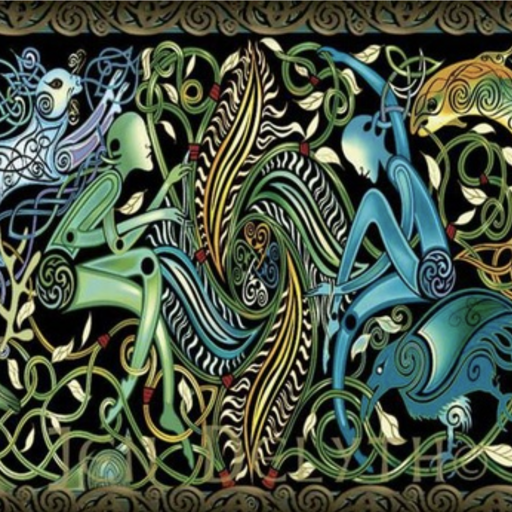

In [1270]:
#@title This is the _style_ image
style_image = open_image(style_url)
print(style_image.size)
style_image.save(style_image_path)
style_image = style_image.resize((IMAGE_WIDTH, IMAGE_HEIGHT), resample=Image.BICUBIC)
print(style_image.size)
style_image

# Build the algorithm

## Feature loss and total variation

### Feature losses

The feature loss is a loss based on which features a neural network find inside an image. We have two such losses.


The first loss is the content loss, based on what content an image contain.
It is basically like a Mean Square Error. But instead of computing the MSE on the content image's pixels and the computed image's pixels, we compute the MSE between the activation of some layers of VGG19 after running our images through it.

To compute the activation layer, we add a pytorch block named ContentLoss inside the VGG network.

In [1271]:
class ContentLoss(nn.Module):
  def __init__(self, target,):
    super(ContentLoss, self).__init__()
    # We 'detach' the target content from the tree used
    # to dynamically compute the gradient: this is a stated value,
    # not a variable.
    self.target = target.detach()

  def forward(self, input):
    self.loss = F.mse_loss(input, self.target)
    return input

The second loss is the style loss. Instead of looking directly to activation of the layer, we first make a computation that compute somehow  the _angle_ between the features detected by the neural network.

We compute the [gram matrix](https://en.wikipedia.org/wiki/Gramian_matrix), which is a matrix whose coefficients are the dot product of two features vectores in the same activation layer from a single image.

We then have for each activation layer, two gram matrix (one from the style image, and one from the cotent image). We simply compute the MSE between the pairs of matrices.

The following code allow to plug a layer in VGG19 retreiving the gram matrices from each activation layer of interest.

---
__Why do I call this values _angles_?__

The Gram matrix is the matrix $G_{ij} = <v_i, v_j>$ is obtained by doing the dot product of each pair of feature vector. The dot product of two vectors $u_i$ and $v_i$ in $\mathbb{R}^3$ can be expressed as $||u_i|| .  ||v_i|| . \cos(u_i, v_i)$ where the two first terms are the length of the vectors, and the third is the cosine of the angle between this vectors.
Therefor, you can see the value of this dot product as a function of the _angle between two features_.

In [1272]:
class StyleLoss(nn.Module):
  def __init__(self, target_feature):
    super(StyleLoss, self).__init__()
    self.target = self.gram_matrix(target_feature).detach()

  def forward(self, input):
    G = self.gram_matrix(input)
    self.loss = F.mse_loss(G, self.target)
    return input

  @staticmethod
  def gram_matrix(input):
    a, b, c, d = input.size()
    # Here:
    # a is the batch size(=1)
    # b is the number of feature maps
    # (c,d) are the dimensions of a feature map

    # We reshape the activation layer into a collection of feature vectors
    features = input.view(a * b, c * d)

    # Compute the gram product
    G = torch.mm(features, features.t())  

    # We 'normalize' the values of the gram matrix
    # by dividing by the norm of gram matrix filled with ones.
    return G.div((a * b * c * d) ** 0.5)

### Total Variation

The last loss is a _smoothing loss_.



This is called the total variation because it basically count the amplitude of all the variations happening in the image. Hight amplitude variation are caused by high constrats / brutal change of pixel values.

Minimizing the total variation of an image can to reducing noise (it is called [total variation denoising](https://en.wikipedia.org/wiki/Total_variation_denoising)). But you have to be carefull, because an image with a minimal total variation is a uniformly colored square. And it would be a really boring and uninteresting picture.

Too much total variation weight will lead to darker / less colorful images. But too few of it will generate very noisy images, without the "brush painting" style we are often loooking for in style transfer.

Since this is computed only from the resulting image , we just need a function to compute it.

---
_How is computed total variation ?_

Total variation is express by $\sum_{i, j} \sqrt{(x_{i+1, j}-x_{i, j})^2 + (x_{i+1, j}-x_{i, j})^2}$ where $x_{i, j}$ is the pixel at coordinates $(i, j)$. This is basically the euclidean norm of all the partial horizontal and vertical derivative of the surface given by $i, j \mapsto x_{i, j}$.
We are basically summing all the local derivative along the height map defined by the image.

This formula have the nice property to give a value which is invariant (up to an error introduced by the discrete nature of the image) by rotation.


In [1273]:
def total_variation_loss(x): # Expect a mini batch of dim NxWxH
  image_height = x.shape[1]
  image_width = x.shape[2]
  dx = x[:, :image_height-1, :image_width-1, :] - x[:, 1:, :image_width-1, :]
  dy = x[:, :image_height-1, :image_width-1, :] - x[:, :image_height-1, 1:, :]
  loss = (dx ** 2 + dy ** 2).sum() ** 0.5
  # Return loss normalized by image and batch size
  return loss / (image_width * image_height * x.shape[0])

### Normalization

We add one more block to automatically rescale and remove the mean of the images going through VGG19.

While training neural network on image dataset, all imges are their mean removed, and values are rescaled according to the standard deviation of the dataset. This is a common processing which makes the neural network convergence easier. The only implication is that once we want to use this network, we have to normalise the input image according to the coefficients used during training.

In [1274]:
# Create a module to normalize input image so we can easily put it in a
# nn.Sequential
class Normalization(nn.Module):
  def __init__(self, mean, std):
    super(Normalization, self).__init__()
    # Reshape the mean and std to make them [C x 1 x 1] so that they can
    # directly broadcast to image Tensor of shape [B x C x H x W].
    # B is batch size. C is number of channels. H is height and W is width.
    self.mean = torch.tensor(mean).view(-1, 1, 1)
    self.std = torch.tensor(std).view(-1, 1, 1)

  def forward(self, img):
    # Normalize img
    return (img - self.mean) / self.std


# Download and build VGG19

We now load our pretrained neural network (VGG19) for computing the losses.

In [1275]:
# Neural network used.
cnn = models.vgg19(pretrained=True).features.to(device).eval()

# Normalization mean and standard deviation.
cnn_normalization_mean = torch.tensor([0.485, 0.456, 0.406]).to(device)
cnn_normalization_std = torch.tensor([0.229, 0.224, 0.225]).to(device)

We now build the actual network which will be called hundreads of times by the style transfer algorithm.

We only keep the layers required to compute the feature loss, and throw everything else away. We interleave our Normalization, StyleLoss and ContentLoss layers between VGG19's layers.

In [1276]:
def get_model_and_losses(style_img, content_img,
                               cnn=cnn,
                               cnn_normalization_mean=cnn_normalization_mean,
                               cnn_normalization_std=cnn_normalization_std):
  # We make a deep copy of vgg19 in order to not modify the original
  cnn = copy.deepcopy(cnn)
  
  # Normalization module
  normalization = Normalization(cnn_normalization_mean, cnn_normalization_std).to(device)

  # This list will contain the losses computed by the network.
  content_losses = []
  style_losses = []

  # We rebuild the model as a nn sequential whose first layer is
  # our normalization layer.
  model = nn.Sequential(normalization)

  # We brows the layer of `cnn` and stack them into `model`.
  i = 0  # Incremented every time we see a conv layer.
  for layer in cnn.children():

    if isinstance(layer, nn.Conv2d):
        i += 1
        name = 'conv_{}'.format(i)
    elif isinstance(layer, nn.ReLU):
        name = 'relu_{}'.format(i)
        # The in-place version doesn't play very nicely with the ContentLoss
        # and StyleLoss we insert below. So we replace with out-of-place
        # ones here.
        layer = nn.ReLU(inplace=False)
    elif isinstance(layer, nn.MaxPool2d):
        name = 'pool_{}'.format(i)
    elif isinstance(layer, nn.BatchNorm2d):
        name = 'bn_{}'.format(i)
    else:
        raise RuntimeError('Unrecognized layer: {}'.format(layer.__class__.__name__))

    model.add_module(name, layer)

    # Check if the layer we just added was in the content layer list.
    # If so, we just stack a Content Loss layer.
    if name in content_layers:
      target = model(content_img).detach()
      content_loss = ContentLoss(target)
      model.add_module("content_loss_{}".format(i), content_loss)
      content_losses.append(content_loss)

    # Check if the layer we just added was in the style layer list.
    # If so, we just stack a Style Loss layer.
    if name in style_layers:
      target_feature = model(style_img).detach()
      style_loss = StyleLoss(target_feature)
      model.add_module("style_loss_{}".format(i), style_loss)
      style_losses.append(style_loss)

  # Now we trim off the layers after the last content and style losses
  # to keep the model as small as possible.
  for i in range(len(model) - 1, -1, -1):
      if isinstance(model[i], ContentLoss) or isinstance(model[i], StyleLoss):
          break

  model = model[:(i + 1)]

  return model, style_losses, content_losses

# Running the algorithm

We write a function converting PIL images to a `torch.Tensor` and apply it to our input images.

In [1277]:
def image_to_tensor(image):
  # Transform to tensor
  image = transforms.ToTensor()(image)
  # Fake batch dimension required to fit network's input dimensions
  image = image.unsqueeze(0)
  # Move to the right device and convert to float
  return image.to(device, torch.float)

content_img = image_to_tensor(content_image)
style_img = image_to_tensor(style_image)

We now declare the inverse function, converting back tensor to images.

In [1278]:
# Reconvert a tensor into PIL image
def tensor_to_image(tensor):
  img = (255 * tensor).cpu().detach().squeeze(0).numpy()
  img = img.clip(0, 255).transpose(1, 2, 0).astype("uint8")
  return Image.fromarray(img)

We now generate or load the input image from which we are going to converge.

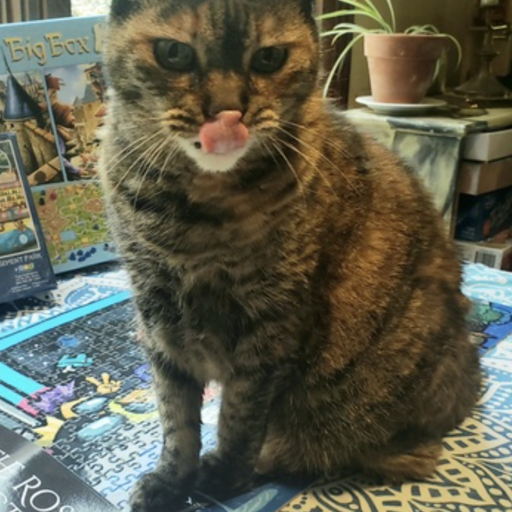

In [1279]:
#@title This is the _input_ image
if INPUT_IMAGE == 'noise':
  input_img = torch.randn(content_img.data.size(), device=device)
elif INPUT_IMAGE == 'content':
  input_img = content_img.clone()
elif INPUT_IMAGE == 'style':
  input_img = style_img.clone()
else:
  image = open_image(INPUT_IMAGE).resize((IMAGE_SIZE, IMAGE_SIZE))
  input_img = image_to_tensor(image)
  input_img += torch.randn(content_img.data.size(), device=device)*0.1

# To visualise it better, instead of clipping values, we rescale
# them to fit [-1,1], and convert to an image. This is mostly because
# the visualization given is closer to what the actual values stored
# in the tensor are.
if INPUT_IMAGE == 'noise':
  img = transforms.ToPILImage()(input_img[0].cpu())
else:
  img = tensor_to_image(input_img[0])
img

We have to choose an optimisation algorithm for our gradient descent.
The algorithm giving the best visual result is LBFGS. But you can try other algorithms like Adam, RAdam, SGD...

In [1280]:
def get_input_optimizer(input_img):
  # This line tell LBFGS what parameters we should optimize
  optimizer = optim.LBFGS([input_img.requires_grad_()])
  #optimizer = optim.Adam([input_img.requires_grad_()])
  return optimizer

We add one more function in order to display the evolution of the input image while the algorithm run.

In [1281]:
def show_evolution(tensor, history=[], title=None):
    image = tensor.cpu().clone().squeeze(0)
    image = tensor_to_image(image)
    # Display a big figure
    plt.rcParams['figure.figsize'] = [10, 5]
    plt.figure()
    # Image
    plt.subplot(121)
    plt.imshow(image)
    plt.axis('off')
    if title is not None:
        plt.title(title)
    # Losses
    ax = plt.subplot(122)
    plt.yscale('log')
    plt.title('Losses')
    import numpy as np
    history = np.array(history).T
    plt.plot(history[0], label='Style')
    plt.plot(history[1], label='Content')
    plt.plot(history[2], label='Variation')
    plt.plot(history[3], label='Sum')
    plt.legend(loc="upper right")
    plt.ylim((0.5,1000))
    # Finaly show the graph
    plt.show()
    # Display a textual message
    print('Style Loss : {:4f} Content Loss: {:4f} Variation Loss: {:4f} Sum: {:4f}'.format(
        history[0][-1], history[1][-1], history[2][-1], history[3][-1]))

We are now ready to converge toward our AI painted image.

Building the style transfer model..
overhead time 1281.72 seconds
Optimizing..


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  if __name__ == '__main__':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  # Remove the CWD from sys.path while we load stuff.


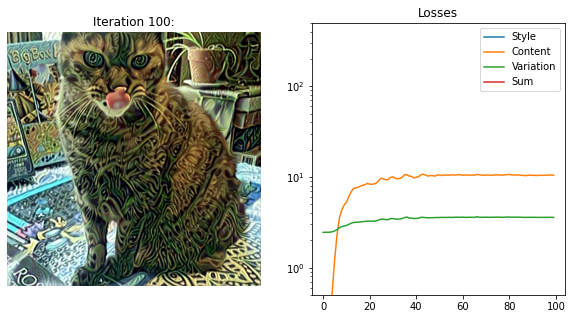

Style Loss : 26812.144531 Content Loss: 10.424606 Variation Loss: 3.571177 Sum: 26826.138672


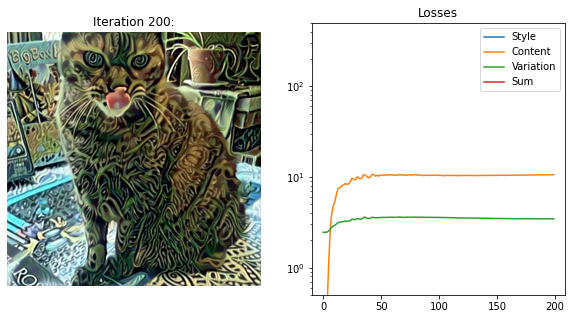

Style Loss : 5998.360352 Content Loss: 10.570786 Variation Loss: 3.448376 Sum: 6012.379395


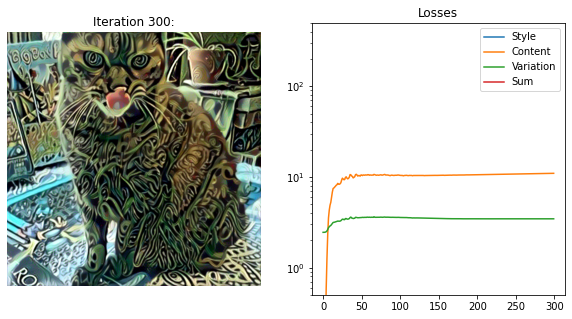

Style Loss : 2717.165283 Content Loss: 10.960432 Variation Loss: 3.448668 Sum: 2731.574463


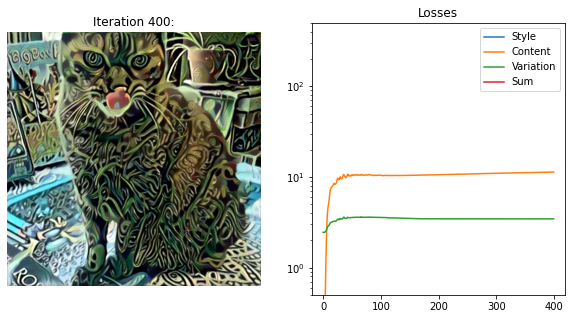

Style Loss : 1578.466187 Content Loss: 11.311218 Variation Loss: 3.444668 Sum: 1593.222046


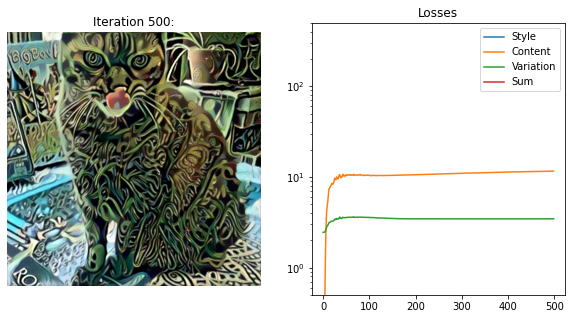

Style Loss : 1079.109985 Content Loss: 11.584219 Variation Loss: 3.449122 Sum: 1094.143311


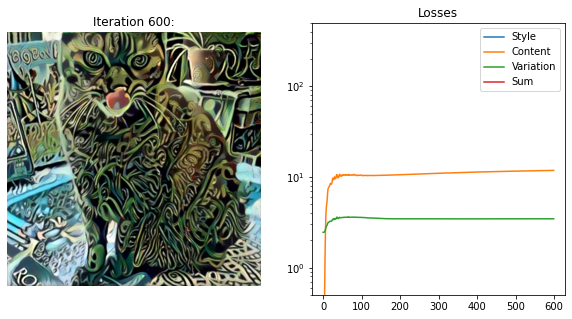

Style Loss : 810.671509 Content Loss: 11.804792 Variation Loss: 3.451857 Sum: 825.928162


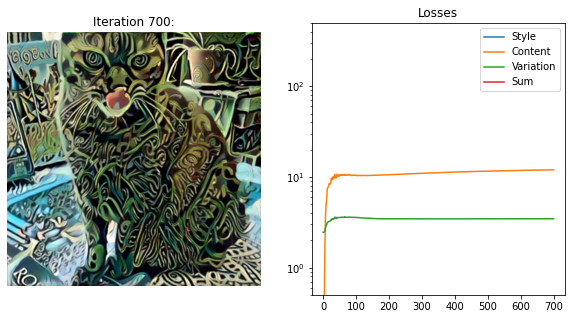

Style Loss : 645.061279 Content Loss: 11.986217 Variation Loss: 3.454544 Sum: 660.502014


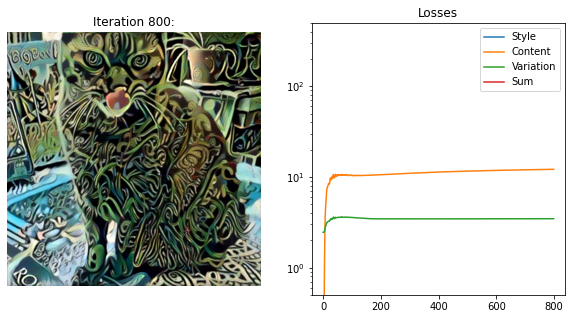

Style Loss : 534.493164 Content Loss: 12.132701 Variation Loss: 3.458309 Sum: 550.084167


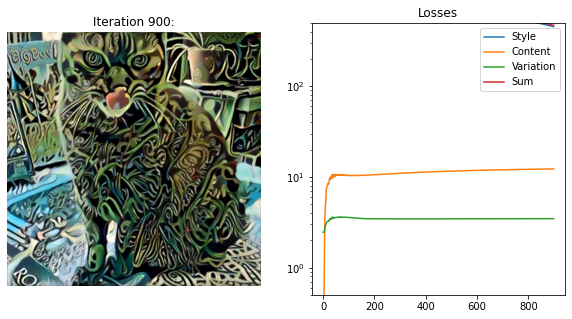

Style Loss : 456.310852 Content Loss: 12.261009 Variation Loss: 3.463027 Sum: 472.034882


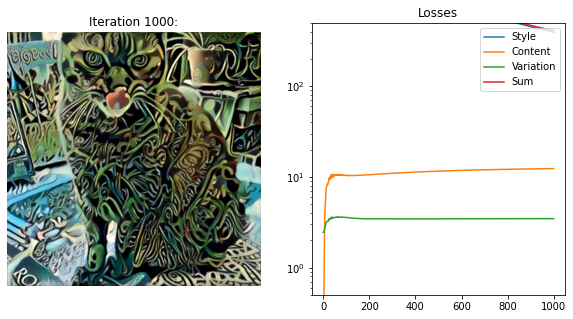

Style Loss : 396.158936 Content Loss: 12.375227 Variation Loss: 3.466792 Sum: 412.000946


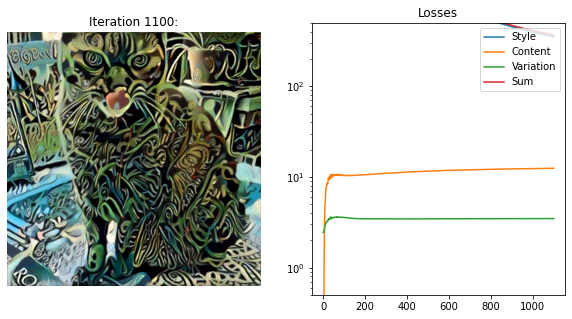

Style Loss : 350.856964 Content Loss: 12.466255 Variation Loss: 3.469609 Sum: 366.792816


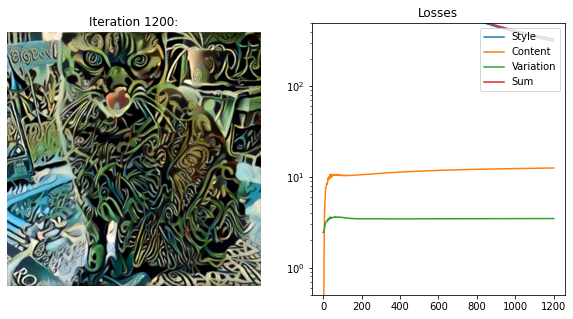

Style Loss : 315.733582 Content Loss: 12.549983 Variation Loss: 3.472868 Sum: 331.756439


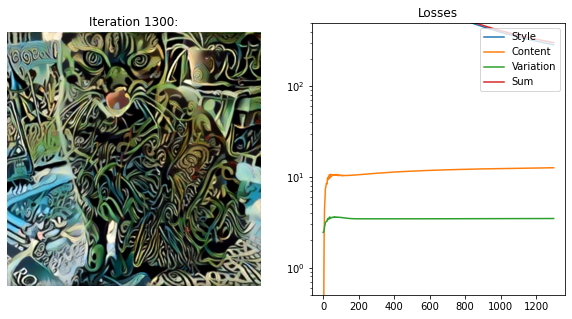

Style Loss : 287.388641 Content Loss: 12.623545 Variation Loss: 3.475519 Sum: 303.487701


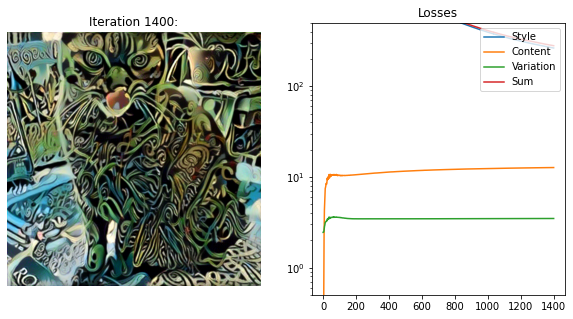

Style Loss : 264.771484 Content Loss: 12.691401 Variation Loss: 3.477650 Sum: 280.940552


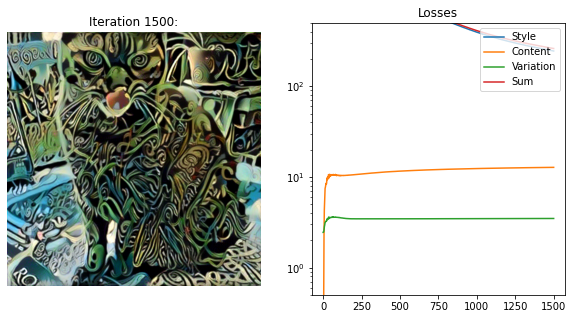

Style Loss : 245.366135 Content Loss: 12.753612 Variation Loss: 3.478742 Sum: 261.598480


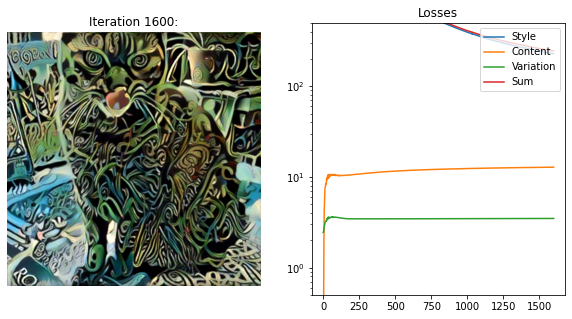

Style Loss : 228.999237 Content Loss: 12.811584 Variation Loss: 3.480329 Sum: 245.291153


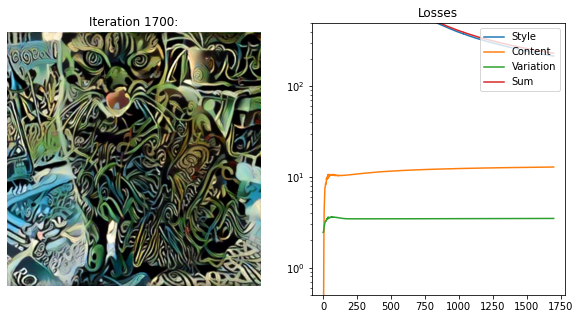

Style Loss : 215.780640 Content Loss: 12.858603 Variation Loss: 3.481348 Sum: 232.120590


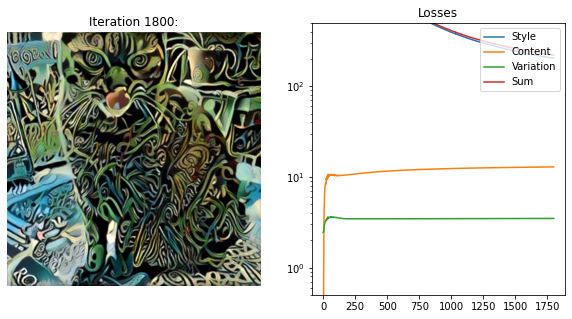

Style Loss : 204.388153 Content Loss: 12.906809 Variation Loss: 3.482555 Sum: 220.777527


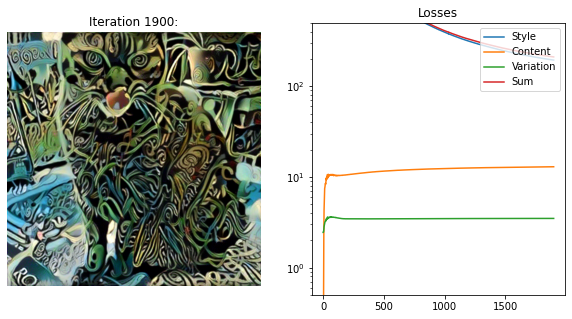

Style Loss : 194.721222 Content Loss: 12.949560 Variation Loss: 3.483500 Sum: 211.154282


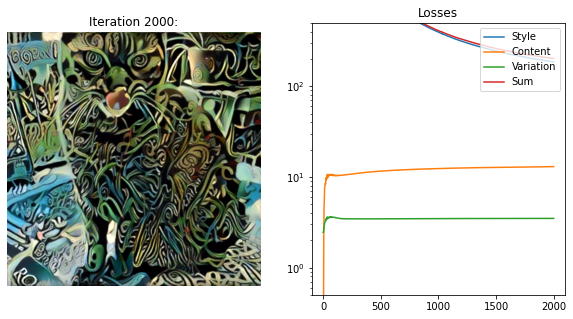

Style Loss : 185.995056 Content Loss: 12.990530 Variation Loss: 3.484835 Sum: 202.470413


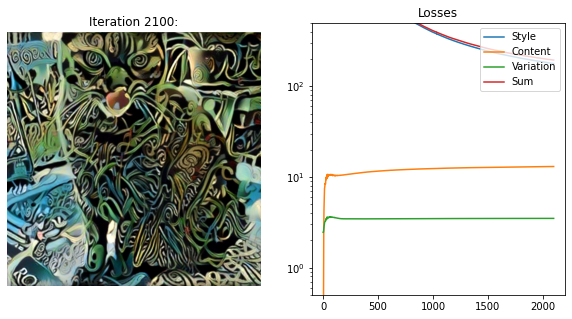

Style Loss : 178.310928 Content Loss: 13.028624 Variation Loss: 3.485966 Sum: 194.825516


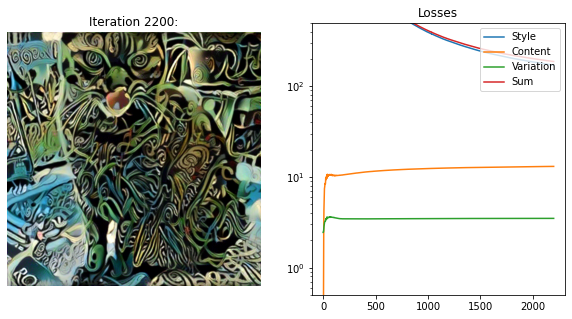

Style Loss : 171.386292 Content Loss: 13.066553 Variation Loss: 3.487264 Sum: 187.940109


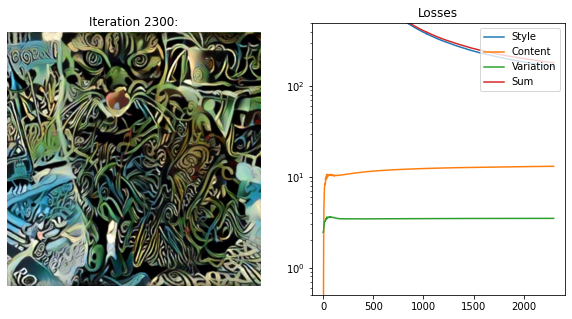

Style Loss : 165.308502 Content Loss: 13.101479 Variation Loss: 3.488477 Sum: 181.898453


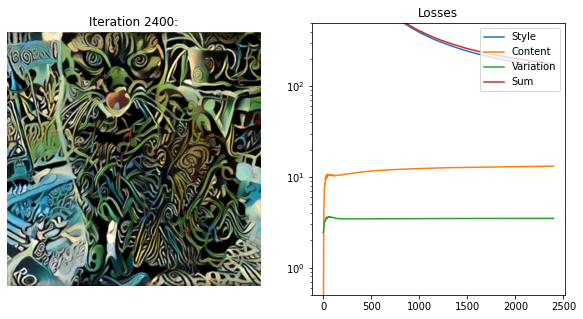

Style Loss : 159.725861 Content Loss: 13.134878 Variation Loss: 3.489582 Sum: 176.350311


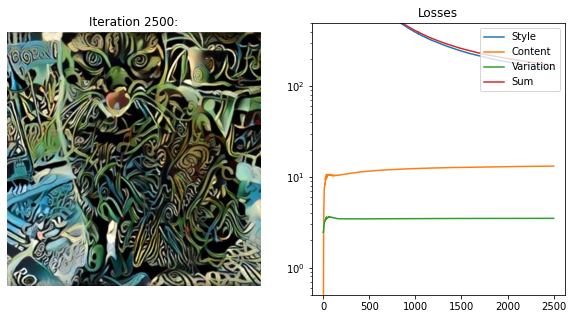

Style Loss : 154.705093 Content Loss: 13.167461 Variation Loss: 3.490929 Sum: 171.363495


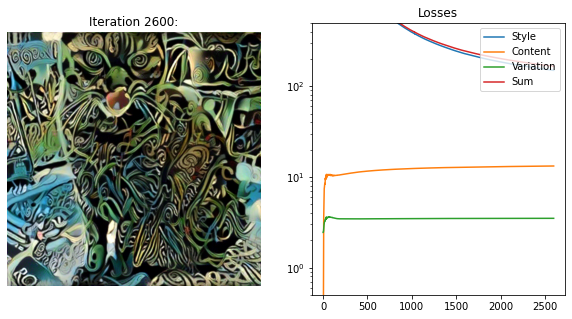

Style Loss : 150.079529 Content Loss: 13.200836 Variation Loss: 3.492667 Sum: 166.773026


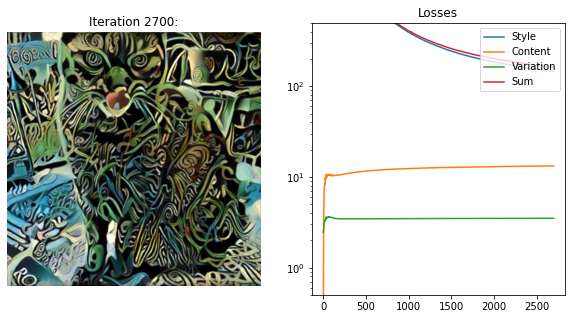

Style Loss : 145.695618 Content Loss: 13.231474 Variation Loss: 3.494126 Sum: 162.421219


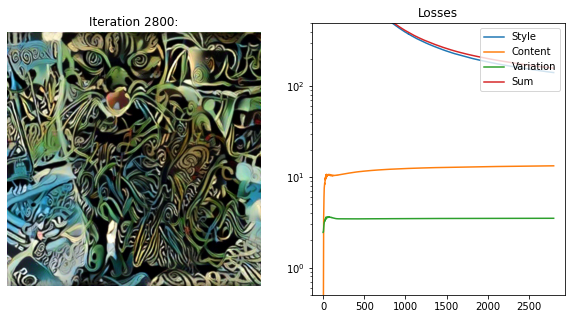

Style Loss : 141.895386 Content Loss: 13.259387 Variation Loss: 3.495547 Sum: 158.650314


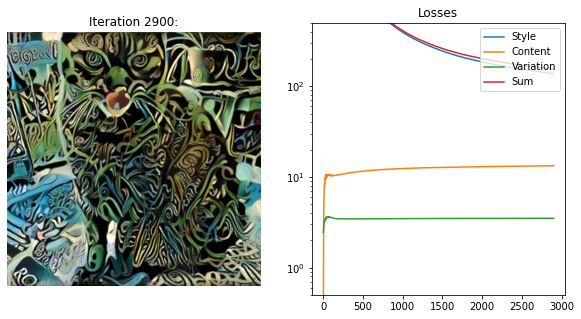

Style Loss : 138.442398 Content Loss: 13.286232 Variation Loss: 3.496745 Sum: 155.225388


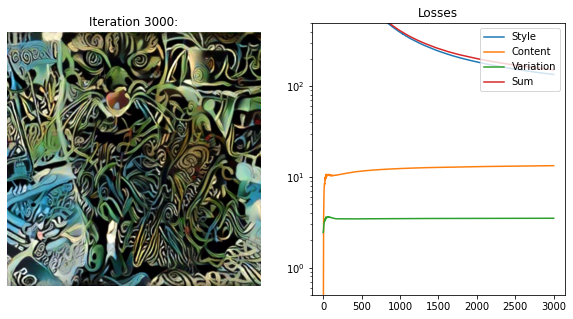

Style Loss : 135.190659 Content Loss: 13.312720 Variation Loss: 3.498077 Sum: 152.001450


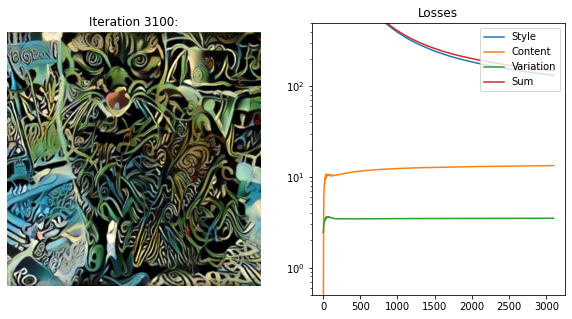

Style Loss : 132.171188 Content Loss: 13.337975 Variation Loss: 3.499331 Sum: 149.008484


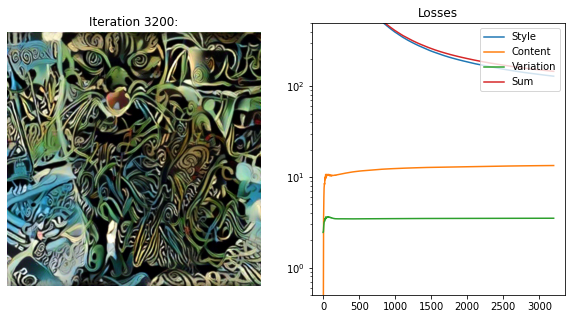

Style Loss : 129.418930 Content Loss: 13.360722 Variation Loss: 3.500252 Sum: 146.279892


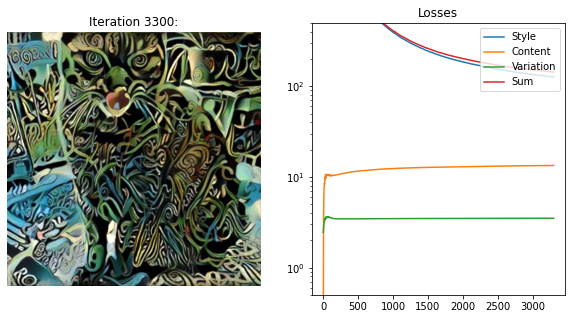

Style Loss : 126.894867 Content Loss: 13.383357 Variation Loss: 3.501208 Sum: 143.779434


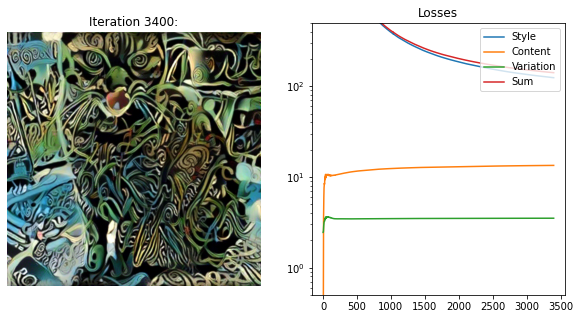

Style Loss : 124.560997 Content Loss: 13.405067 Variation Loss: 3.502114 Sum: 141.468185


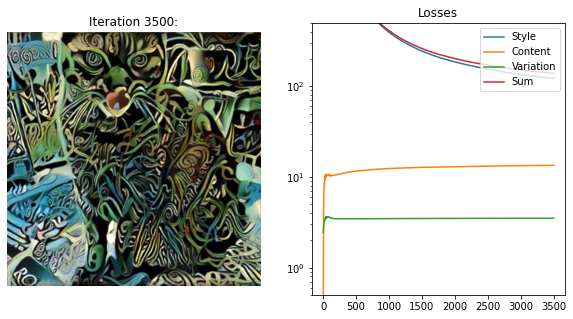

Style Loss : 122.295982 Content Loss: 13.427219 Variation Loss: 3.503231 Sum: 139.226440


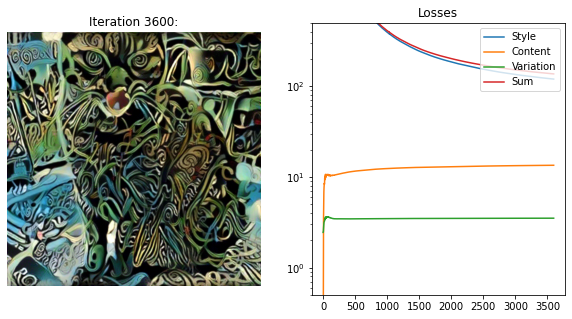

Style Loss : 120.199432 Content Loss: 13.447364 Variation Loss: 3.504083 Sum: 137.150879


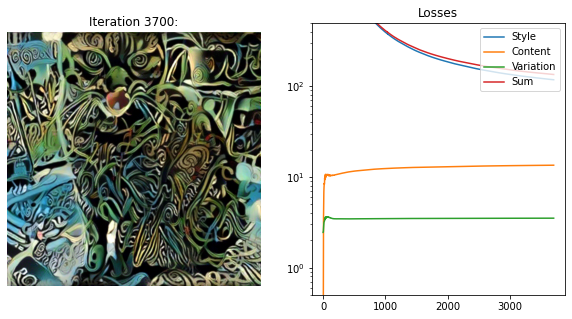

Style Loss : 118.149094 Content Loss: 13.468092 Variation Loss: 3.505164 Sum: 135.122345


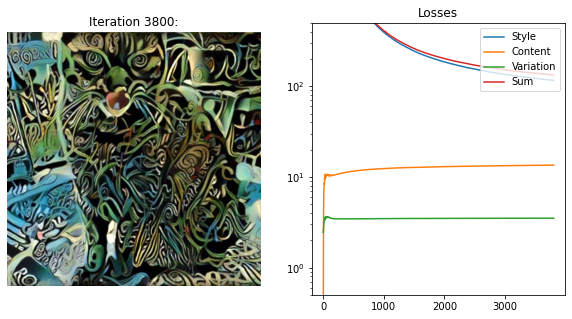

Style Loss : 116.255386 Content Loss: 13.488905 Variation Loss: 3.506250 Sum: 133.250549


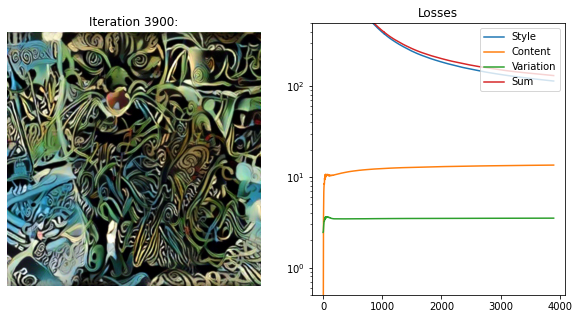

Style Loss : 114.452583 Content Loss: 13.509262 Variation Loss: 3.507257 Sum: 131.469101


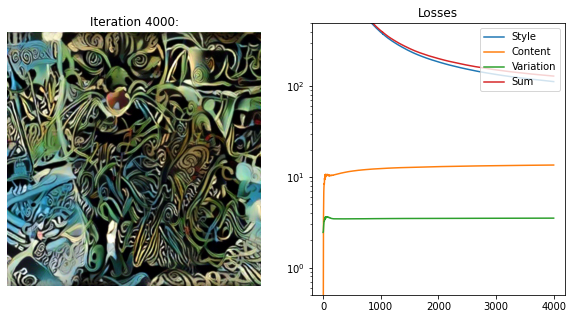

Style Loss : 112.752289 Content Loss: 13.527802 Variation Loss: 3.508098 Sum: 129.788193


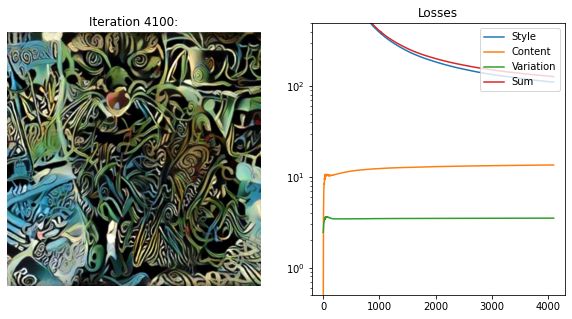

Style Loss : 111.133743 Content Loss: 13.547008 Variation Loss: 3.509041 Sum: 128.189789


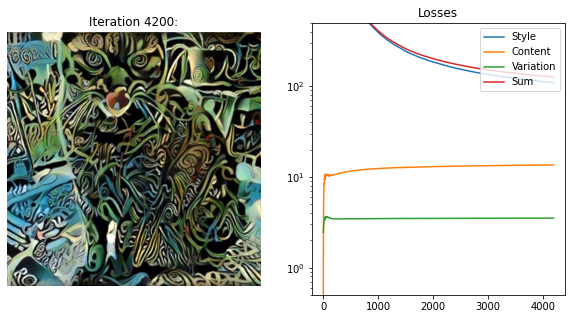

Style Loss : 109.621567 Content Loss: 13.565025 Variation Loss: 3.510027 Sum: 126.696617


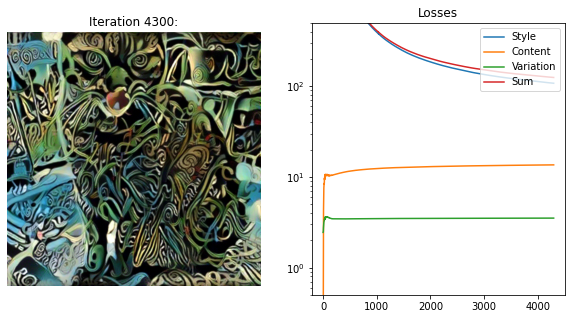

Style Loss : 108.201134 Content Loss: 13.583603 Variation Loss: 3.511080 Sum: 125.295815


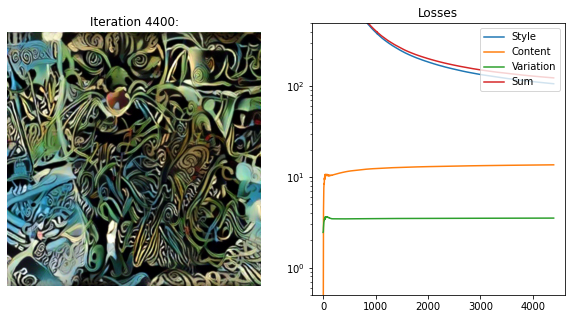

Style Loss : 106.829010 Content Loss: 13.601680 Variation Loss: 3.512156 Sum: 123.942841


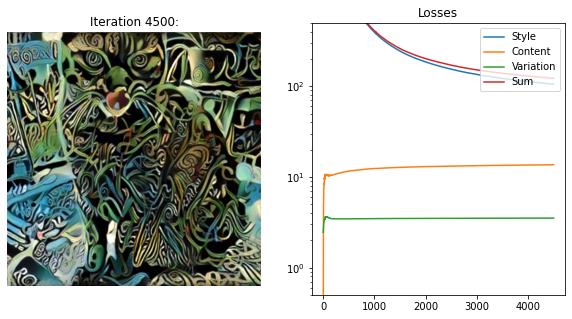

Style Loss : 105.534172 Content Loss: 13.618640 Variation Loss: 3.513206 Sum: 122.666016


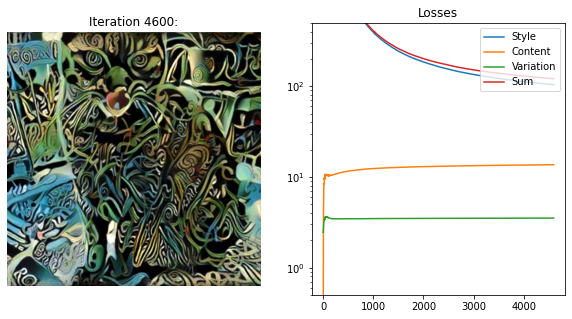

Style Loss : 104.331757 Content Loss: 13.633471 Variation Loss: 3.513991 Sum: 121.479218


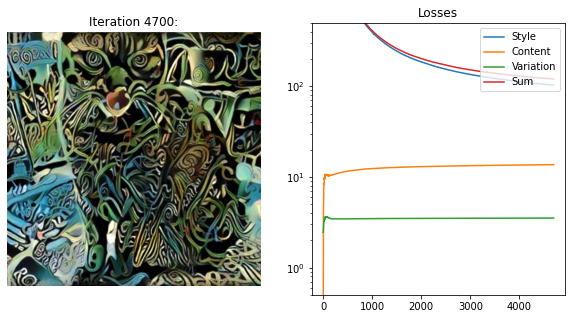

Style Loss : 103.171150 Content Loss: 13.649379 Variation Loss: 3.514836 Sum: 120.335365


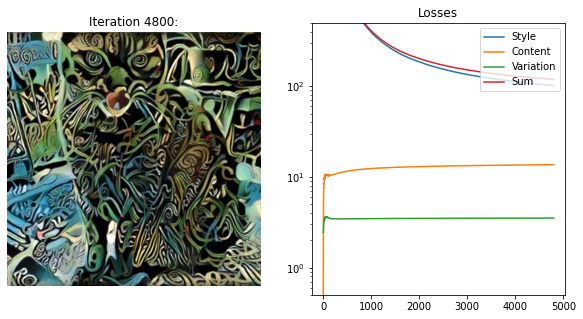

Style Loss : 102.050644 Content Loss: 13.664158 Variation Loss: 3.515726 Sum: 119.230522


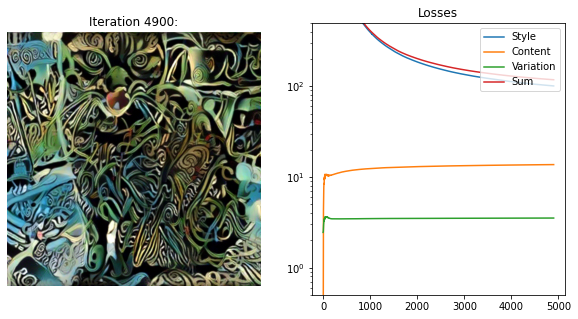

Style Loss : 101.000458 Content Loss: 13.678408 Variation Loss: 3.516658 Sum: 118.195518


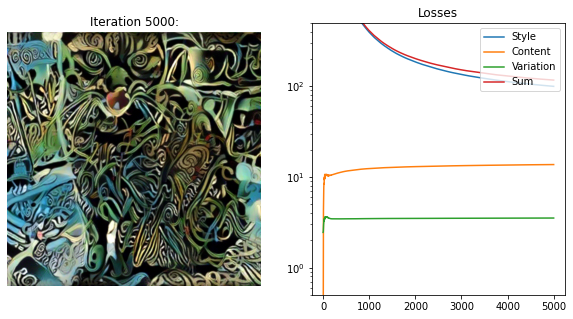

Style Loss : 99.979309 Content Loss: 13.691732 Variation Loss: 3.517563 Sum: 117.188606


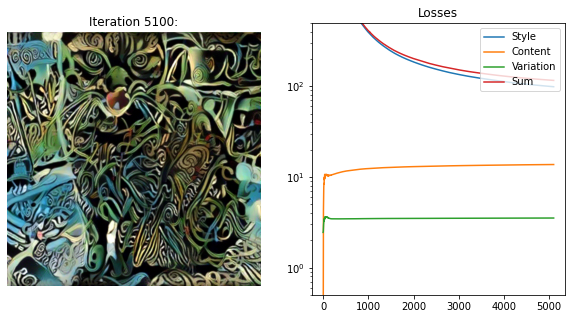

Style Loss : 98.994705 Content Loss: 13.705192 Variation Loss: 3.518404 Sum: 116.218300


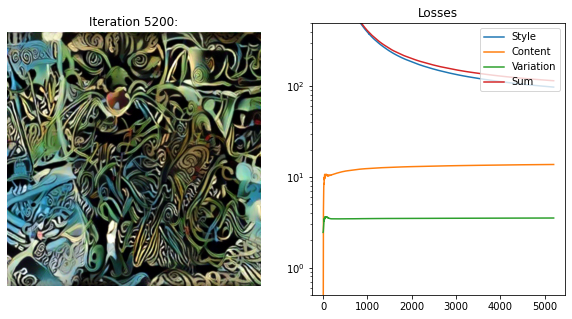

Style Loss : 98.054810 Content Loss: 13.718936 Variation Loss: 3.519256 Sum: 115.292999


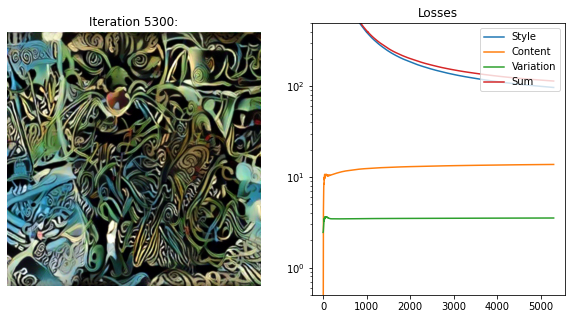

Style Loss : 97.135422 Content Loss: 13.732204 Variation Loss: 3.520080 Sum: 114.387711


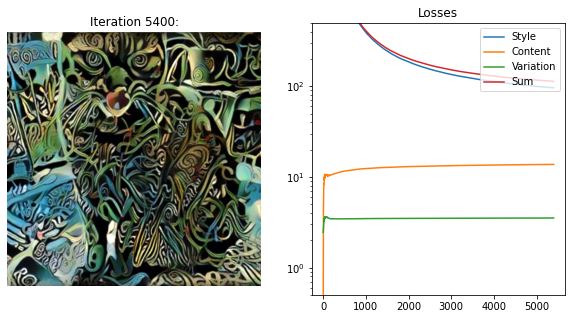

Style Loss : 96.272194 Content Loss: 13.744925 Variation Loss: 3.520885 Sum: 113.538002


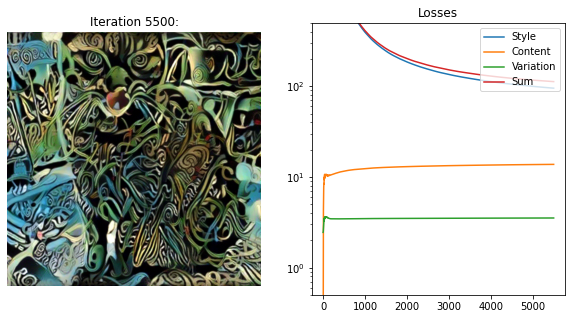

Style Loss : 95.441170 Content Loss: 13.757437 Variation Loss: 3.521798 Sum: 112.720406


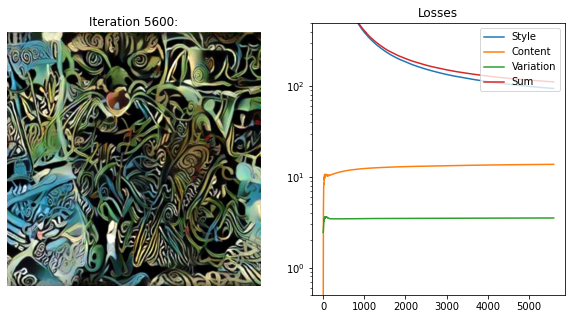

Style Loss : 94.609390 Content Loss: 13.770395 Variation Loss: 3.522762 Sum: 111.902542


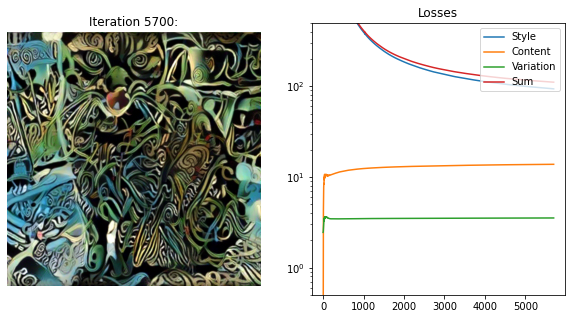

Style Loss : 93.824959 Content Loss: 13.782246 Variation Loss: 3.523698 Sum: 111.130905


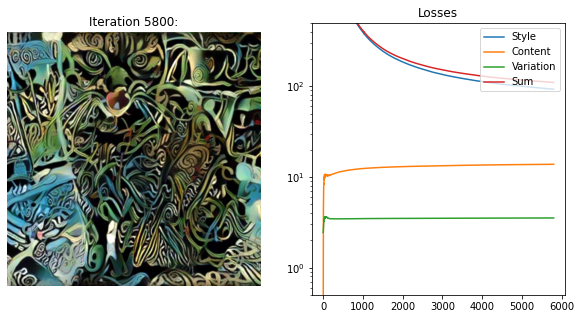

Style Loss : 93.098251 Content Loss: 13.792585 Variation Loss: 3.524357 Sum: 110.415199


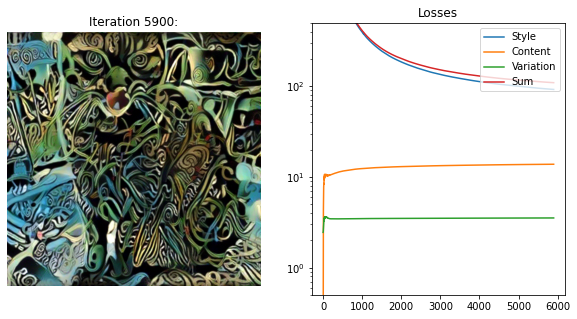

Style Loss : 92.386765 Content Loss: 13.804019 Variation Loss: 3.525219 Sum: 109.716003


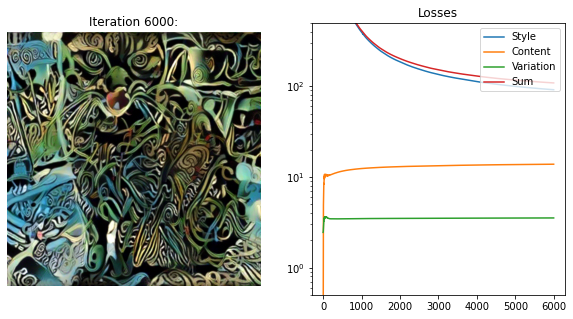

Style Loss : 91.697678 Content Loss: 13.814578 Variation Loss: 3.526054 Sum: 109.038307


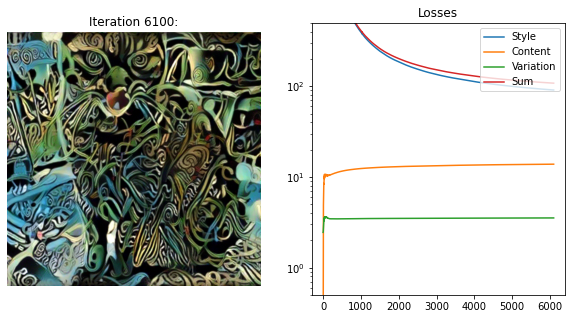

Style Loss : 91.033630 Content Loss: 13.825033 Variation Loss: 3.526875 Sum: 108.385544


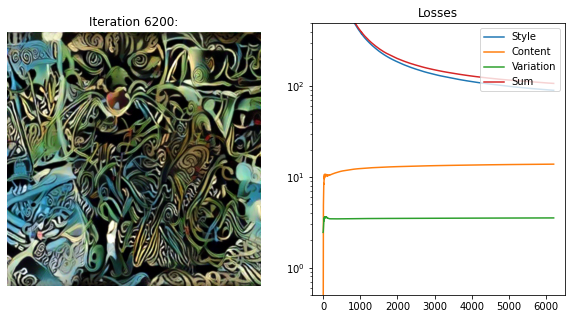

Style Loss : 90.398781 Content Loss: 13.835063 Variation Loss: 3.527654 Sum: 107.761497


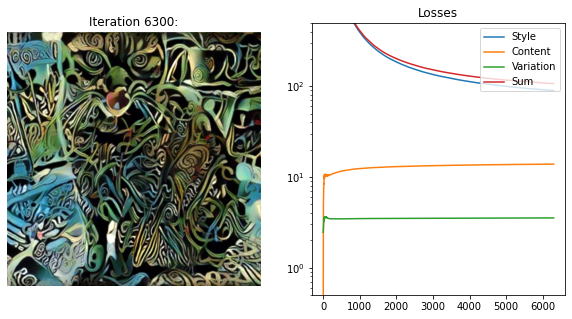

Style Loss : 89.803535 Content Loss: 13.844668 Variation Loss: 3.528371 Sum: 107.176575


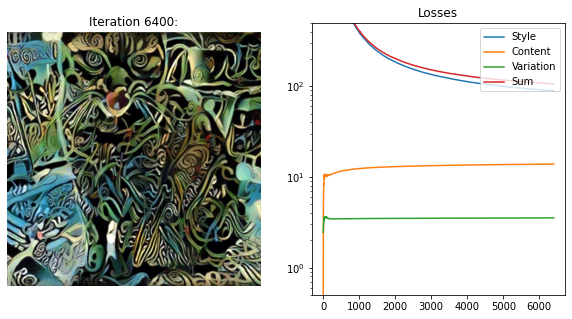

Style Loss : 89.220238 Content Loss: 13.854358 Variation Loss: 3.529130 Sum: 106.603722


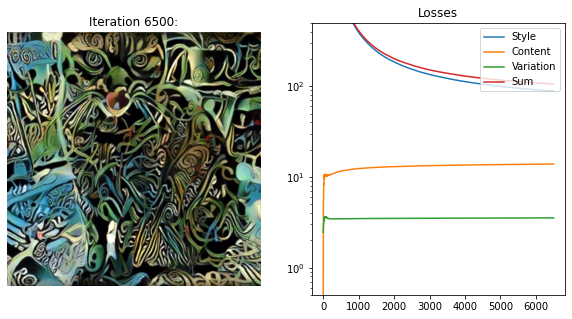

Style Loss : 88.632195 Content Loss: 13.864169 Variation Loss: 3.529906 Sum: 106.026268


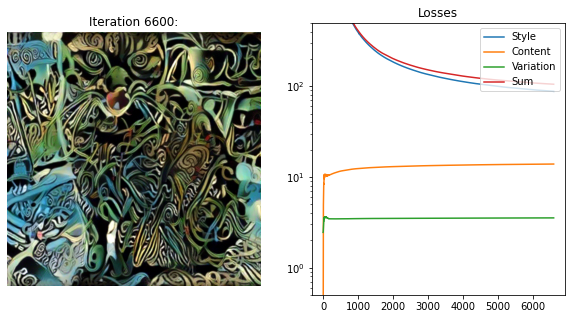

Style Loss : 88.064919 Content Loss: 13.874458 Variation Loss: 3.530747 Sum: 105.470123


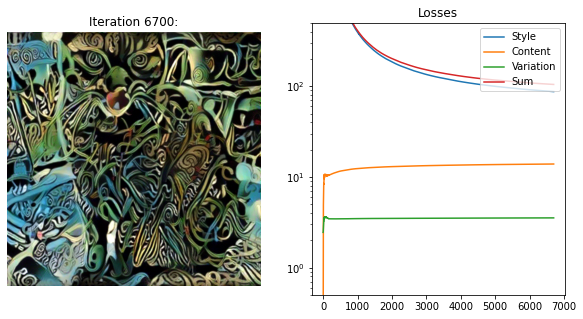

Style Loss : 87.514488 Content Loss: 13.884428 Variation Loss: 3.531620 Sum: 104.930534


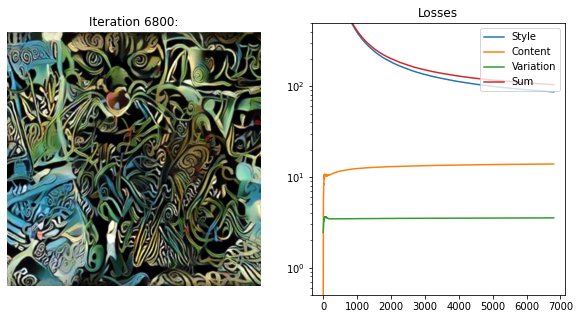

Style Loss : 86.995285 Content Loss: 13.893451 Variation Loss: 3.532380 Sum: 104.421112


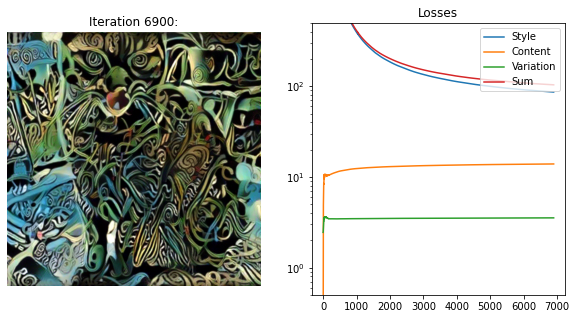

Style Loss : 86.474266 Content Loss: 13.903026 Variation Loss: 3.533246 Sum: 103.910538


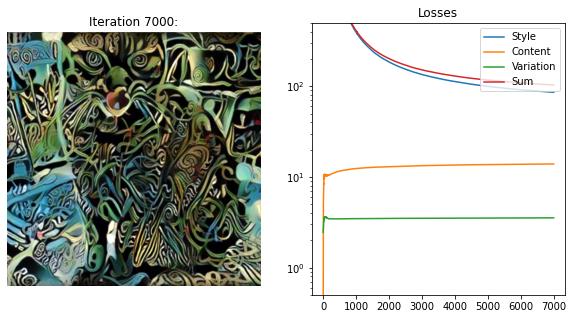

Style Loss : 85.986671 Content Loss: 13.911498 Variation Loss: 3.533940 Sum: 103.432114


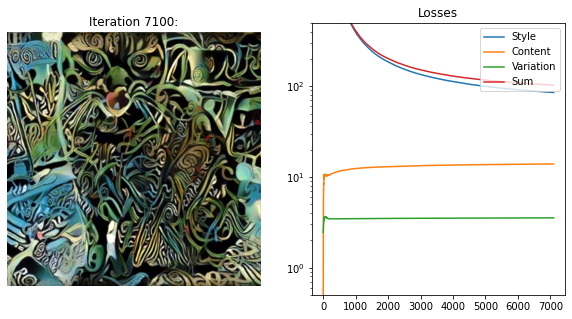

Style Loss : 85.516373 Content Loss: 13.920679 Variation Loss: 3.534763 Sum: 102.971817


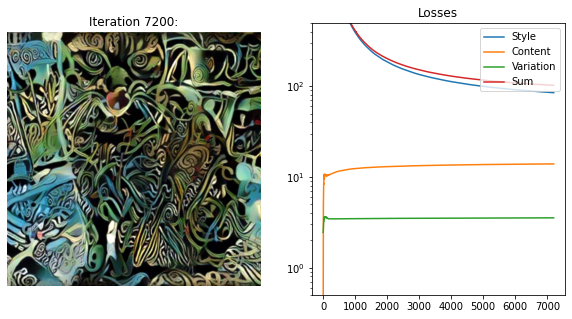

Style Loss : 85.033798 Content Loss: 13.928341 Variation Loss: 3.535338 Sum: 102.497482


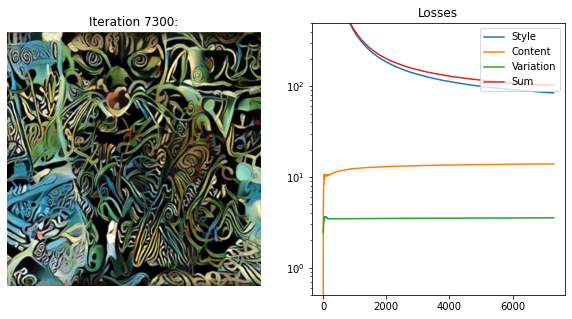

Style Loss : 84.603470 Content Loss: 13.936047 Variation Loss: 3.535992 Sum: 102.075516


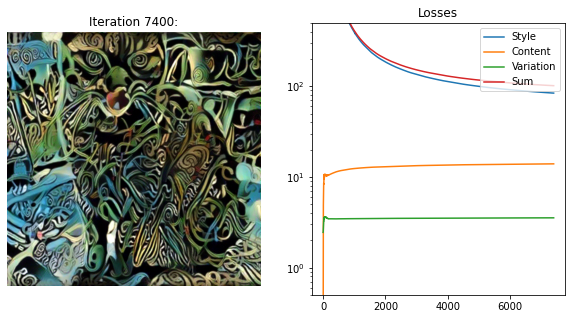

Style Loss : 84.179306 Content Loss: 13.943416 Variation Loss: 3.536559 Sum: 101.659279


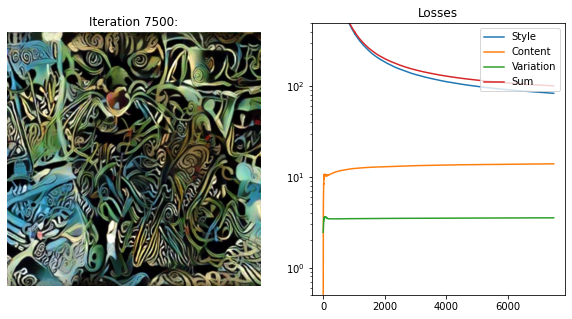

Style Loss : 83.778625 Content Loss: 13.950915 Variation Loss: 3.537228 Sum: 101.266769


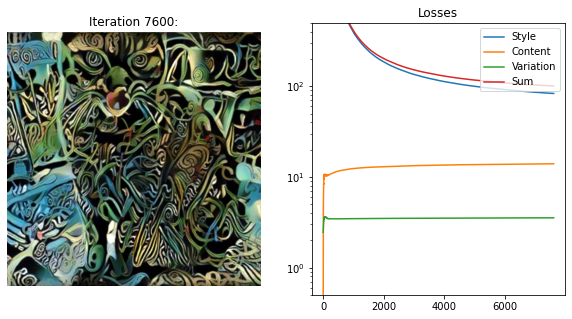

Style Loss : 83.395020 Content Loss: 13.959186 Variation Loss: 3.538046 Sum: 100.892250


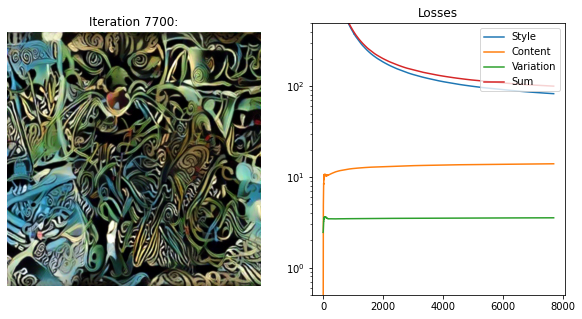

Style Loss : 82.974762 Content Loss: 13.966633 Variation Loss: 3.538678 Sum: 100.480072


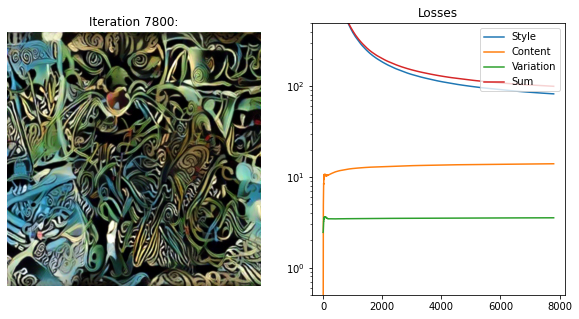

Style Loss : 82.596649 Content Loss: 13.974085 Variation Loss: 3.539323 Sum: 100.110054


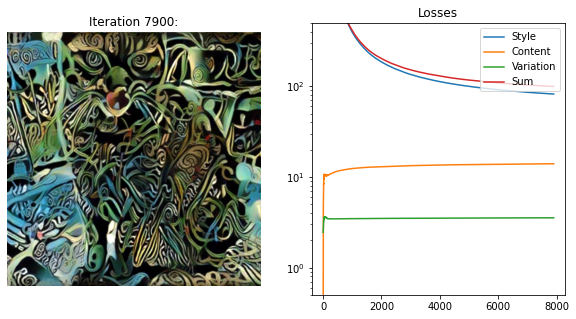

Style Loss : 82.215546 Content Loss: 13.981131 Variation Loss: 3.539903 Sum: 99.736580


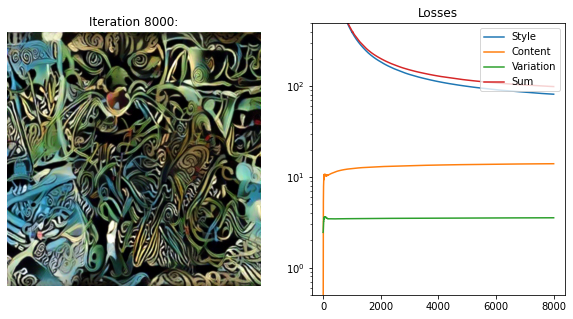

Style Loss : 81.856422 Content Loss: 13.988338 Variation Loss: 3.540615 Sum: 99.385376


In [1282]:
print('Building the style transfer model..')
start_time = time()
overhead_time = start_time - begin_time
print('overhead time %0.2f seconds' % overhead_time)
model, style_losses, content_losses = get_model_and_losses(style_img, content_img)
optimizer = get_input_optimizer(input_img)

print('Optimizing..')
iterations = 0
history=[]
while iterations <= ITERATIONS * 100:
  # Compute the loss and backpropagate to the input_image.
  # (The LBFGS optimizer only accept work through closures.)
  def closure():
      global history
      global iterations
      
      optimizer.zero_grad()
      
      # Compute the total variation loss
      variation_score = total_variation_loss(input_img) * TOTAL_VARIATION_WEIGHT
      # Compute the features through the model
      model(input_img)
      # Compute style and content losses
      style_score = sum(sl.loss for sl in style_losses)
      style_score *= STYLE_WEIGHT / len(style_losses)
      content_score = sum(cl.loss for cl in content_losses)
      content_score *= CONTENT_WEIGHT / len(content_losses)
      # Our global loss is the sum of the 3 values
      loss = style_score + content_score + variation_score
      # Save the value of loss in order to draw them as a graph
      history += [[style_score.item(), content_score.item(), variation_score.item(), loss.item()]]

      # If the iteration is a multiple of 100, display some informations
      iterations += 1
      if iterations % 100 == 0:
          show_evolution(input_img.data.clone().detach().clamp(0, 1), history, title="Iteration %d:" % iterations)
      
      # Backpropagate gradients and leave the optimizer do his job.
      loss.backward()
      return loss

  optimizer.step(closure)


Runtime: 6.09 minutes
Total time: 27.45 minutes
(998, 994)


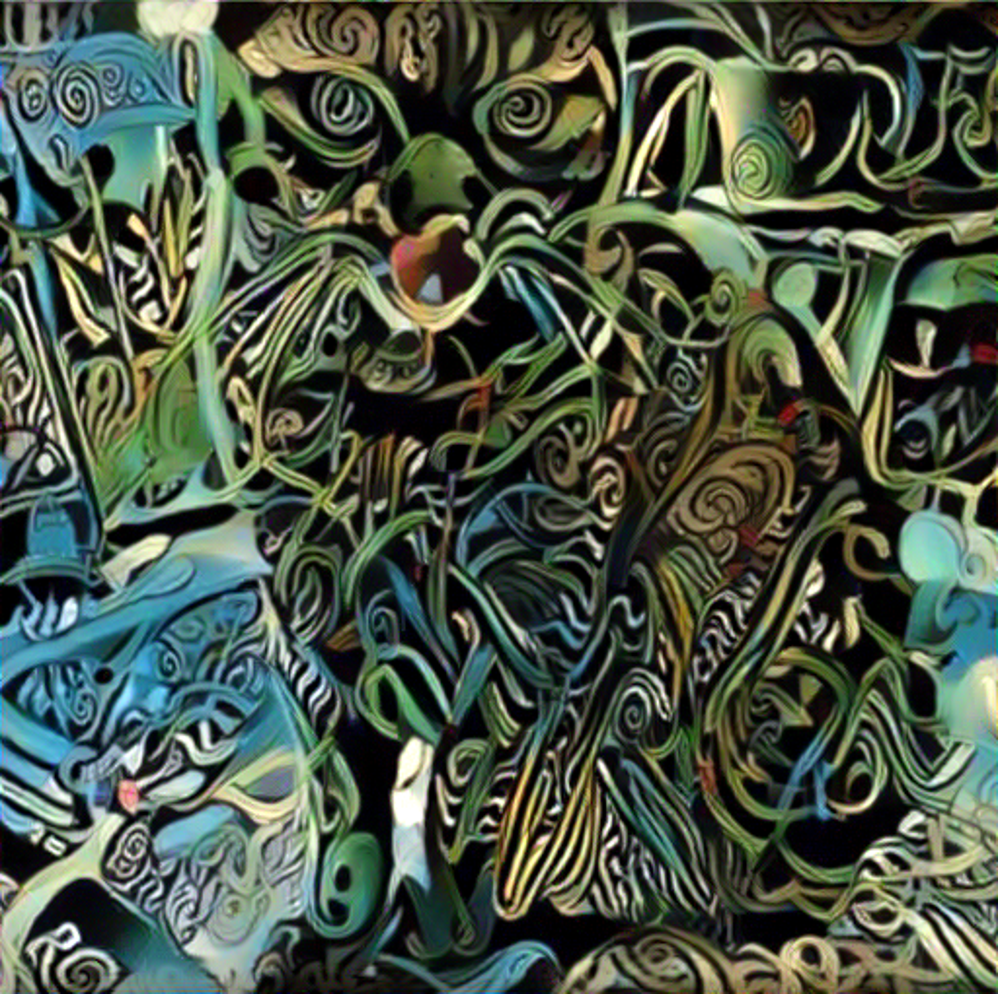

In [1283]:
#@title Our beautiful result
img = tensor_to_image(input_img)
now_time = time()
run_time = (now_time - start_time)/60.0
total_time = (now_time - begin_time)/60.0
print('Runtime: %0.2f minutes' % run_time)
print('Total time: %0.2f minutes' % total_time)

img_orig_size = img.resize(original_image_size, resample=Image.BICUBIC)
img_orig_size.save(output_image_path)
print(img_orig_size.size)
img_orig_size

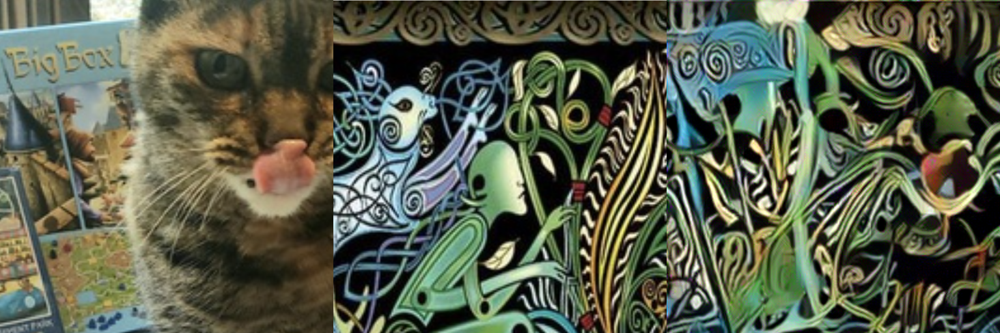

In [1284]:
#@title Visualise combined results
combined = Image.new("RGB", (IMAGE_WIDTH*3, IMAGE_HEIGHT))
x_offset = 0
for image in map(Image.open, [content_image_path, style_image_path, output_image_path]):
    combined.paste(image, (x_offset, 0))
    x_offset += IMAGE_WIDTH

combined.save(combined_image_path)
combined

